In [ ]:
%load_ext autoreload
%autoreload 2
import numpy as np
import numpy.fft as npf
import matplotlib
import matplotlib.pyplot as plt
import time
import imagetools.projectA as im
import imagetools.provided as im1
%matplotlib notebook

# Section 1: Operators

# I) Question 4:

<IPython.core.display.Javascript object>


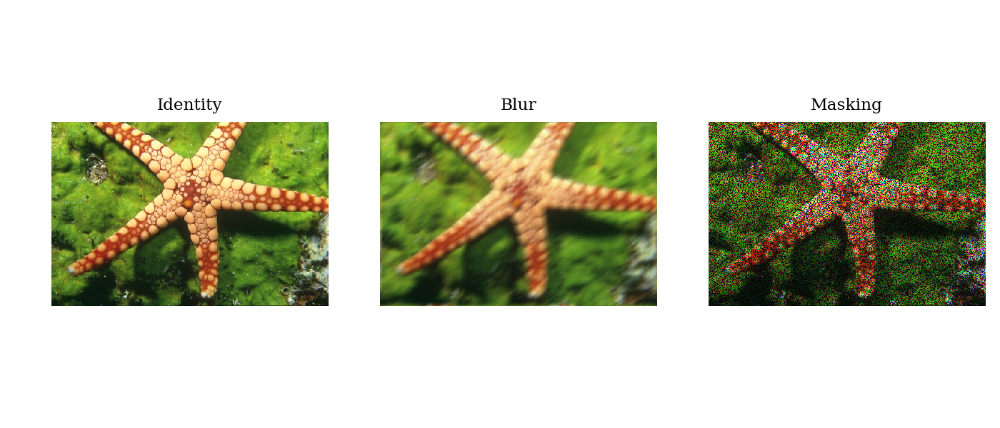

In [9]:
%matplotlib notebook
x=plt.imread('assets/starfish.png')
shape= x.shape
nu=im.kernel('motion')
H_r = im.RandomMasking(shape, 0.4)
H_b = im.Convolution(shape, nu, separable=None)
y= H_b(x)
z= H_r(x)
fig, axes = plt.subplots(ncols=3, figsize=(7,3))
im1.show(x, ax=axes[0])
axes[0].set_title('Identity')
im1.show(y, ax=axes[1])
axes[1].set_title('Blur')
im1.show(z, ax=axes[2])
axes[2].set_title('Masking')
fig.show()

# I) Question 5:

For the Identity operator:

In [10]:
H_i=im.Identity((24,16))
x= np.random.rand(H_i.ishape[0], H_i.ishape[1])
y= np.random.rand(H_i.oshape[0], H_i.oshape[1])
LHS= (H_i(x)*y).sum()
RHS= (H_i.adjoint(y)*x).sum()
np.isclose(LHS, RHS)

True

For the Convolution operator:

In [11]:
nu=im.kernel('motion')
H_c=im.Convolution((24,16), nu)
x= np.random.rand(H_c.ishape[0], H_c.ishape[1])
y= np.random.rand(H_c.oshape[0], H_c.oshape[1])
LHS= (H_c(x)*y).sum()
RHS= (H_c.adjoint(y)*x).sum()
np.isclose(LHS, RHS)

True

For the Random masking operator:

In [12]:
H_r=im.RandomMasking((24,16,3), 0.4)
x= np.random.rand(H_r.ishape[0], H_r.ishape[1], H_r.ishape[2])
y= np.random.rand(H_r.oshape[0], H_r.oshape[1], H_r.oshape[2])
LHS= (H_r(x)*y).sum()
RHS= (H_r.adjoint(y)*x).sum()
np.isclose(LHS, RHS)

True

In [13]:
H_r=im.RandomMasking((24,16), 0.4)
x= np.random.rand(H_r.ishape[0], H_r.ishape[1], H_r.shape[2])
y= np.random.rand(H_r.oshape[0], H_r.oshape[1], H_r.shape[2])
LHS= (H_r(x)*y).sum()
RHS= (H_r.adjoint(y)*x).sum()
np.isclose(LHS, RHS)

True

# I) Question 6:

## For the Identity operator:

In [14]:
tau=1
H_i=im.Identity((24,16))
x= np.random.rand(H_i.ishape[0], H_i.ishape[1])
LHS= H_i.gram_resolvent(x+tau*H_i.gram(x), tau)
np.allclose(LHS, x)

True

## For the Convolution operator:

In [15]:
tau=1
nu=im.kernel('motion')
H_c=im.Convolution((24,16), nu)
x= np.random.rand(H_c.ishape[0], H_c.ishape[1])
LHS= H_c.gram_resolvent(x+tau*H_c.gram(x), tau)
np.allclose(LHS, x, atol=1e-2)

True

## For the Random Masking operator:

In [16]:
tau=1
H_r=im.RandomMasking((24,16,3), 0.4)
x= np.random.rand(H_r.ishape[0], H_r.ishape[1], H_r.ishape[2])
LHS= H_r.gram_resolvent(x+tau*H_r.gram(x), tau)
np.allclose(LHS, x)

True

# Section 2: Anisotropic Diffusion 

# II) Question 8:

<IPython.core.display.Javascript object>


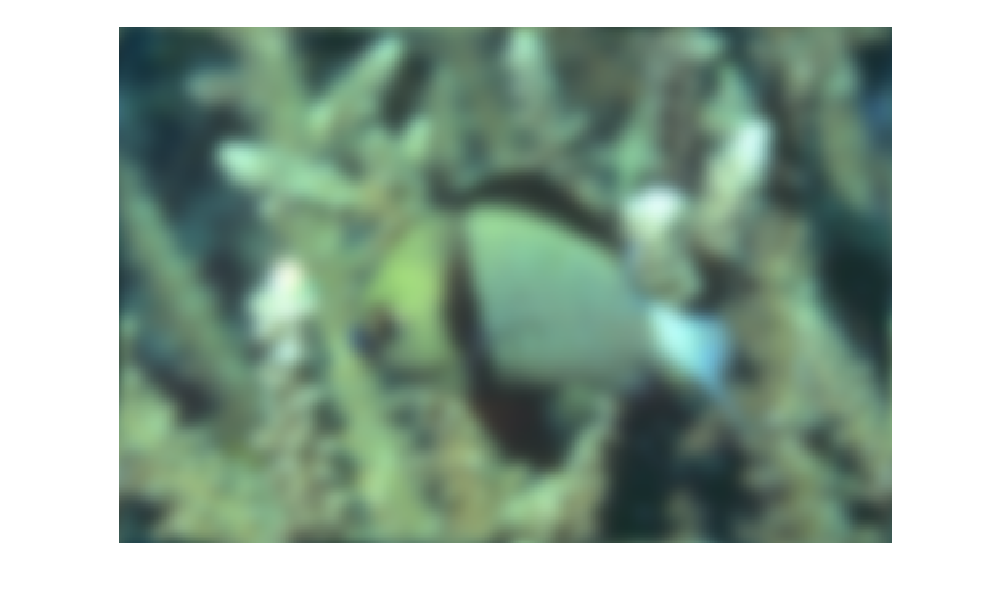

In [18]:
x0=plt.imread('assets/fish.png')
sig = 10/255
y = x0 + sig * np.random.randn(x0.shape[0], x0.shape[1], x0.shape[2])
x=im.heat_diffusion(y, 100, 1/8)
plt.figure()
im1.show(x)

# II) Question 9:

## For the explicit case:

<IPython.core.display.Javascript object>


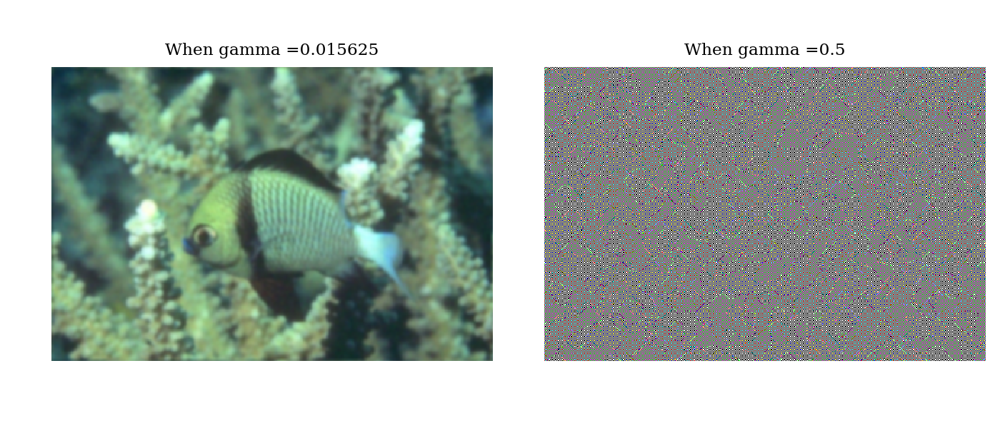

In [19]:
x=im.heat_diffusion(y, 100, 1/64, scheme='explicit')
fig, axes = plt.subplots(ncols=2, figsize=(7,3))
im1.show(x, ax=axes[0])
axes[0].set_title('When gamma =' + str(1/64))
x=im.heat_diffusion(y, 100, 1/2, scheme='explicit')
im1.show(x, ax=axes[1])
axes[1].set_title('When gamma =' + str(1/2))
fig.show()

## For the implicit case:

<IPython.core.display.Javascript object>


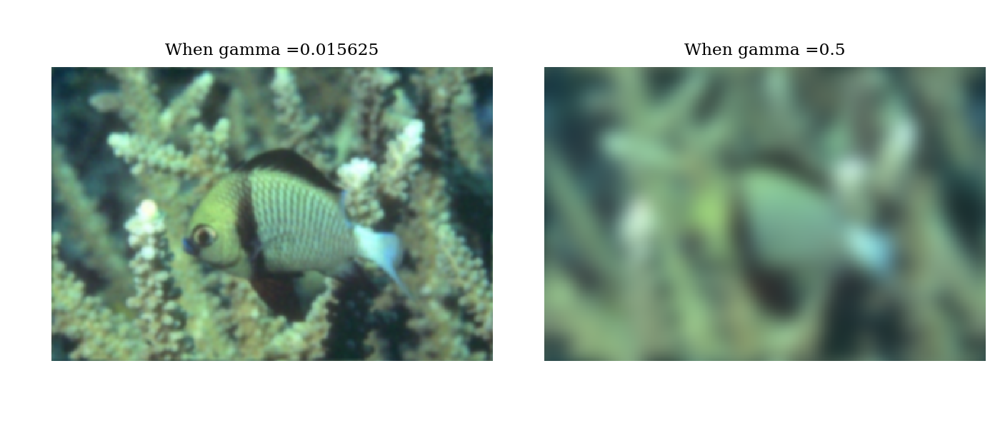

In [20]:
x=im.heat_diffusion(y, 100, 1/64, scheme='implicit')
fig, axes = plt.subplots(ncols=2, figsize=(7,3))
im1.show(x, ax=axes[0])
axes[0].set_title('When gamma =' + str(1/64))
x=im.heat_diffusion(y, 100, 1/2, scheme='implicit')
im1.show(x, ax=axes[1])
axes[1].set_title('When gamma =' + str(1/2))
fig.show()

## For the continuous case:

<IPython.core.display.Javascript object>


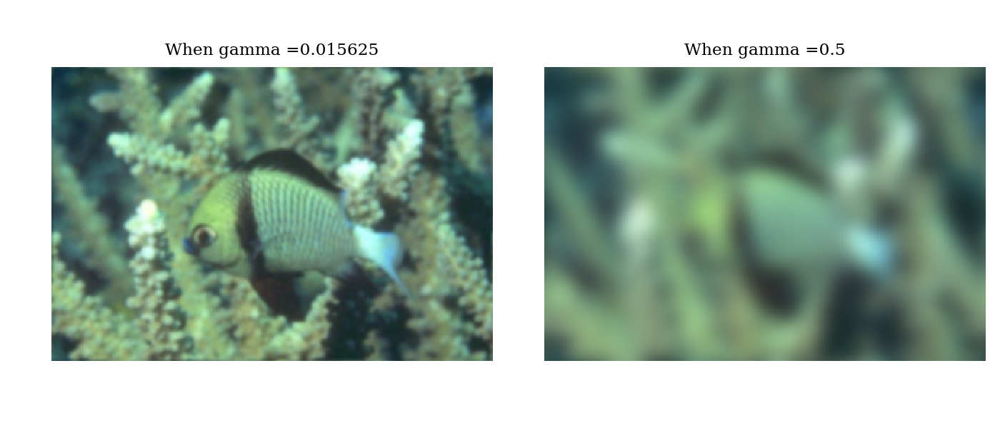

In [21]:
x=im.heat_diffusion(y, 100, 1/64, scheme='continuous')
fig, axes = plt.subplots(ncols=2, figsize=(7,3))
im1.show(x, ax=axes[0])
axes[0].set_title('When gamma =' + str(1/64))
x=im.heat_diffusion(y, 100, 1/2, scheme='continuous')
im1.show(x, ax=axes[1])
axes[1].set_title('When gamma =' + str(1/2))
fig.show()

Conclusion: For lower values of gamma, all three schemes converge and for higher values explicit and continuous schemes perform better but still do not completely converge.

# II) Question 13:

<IPython.core.display.Javascript object>


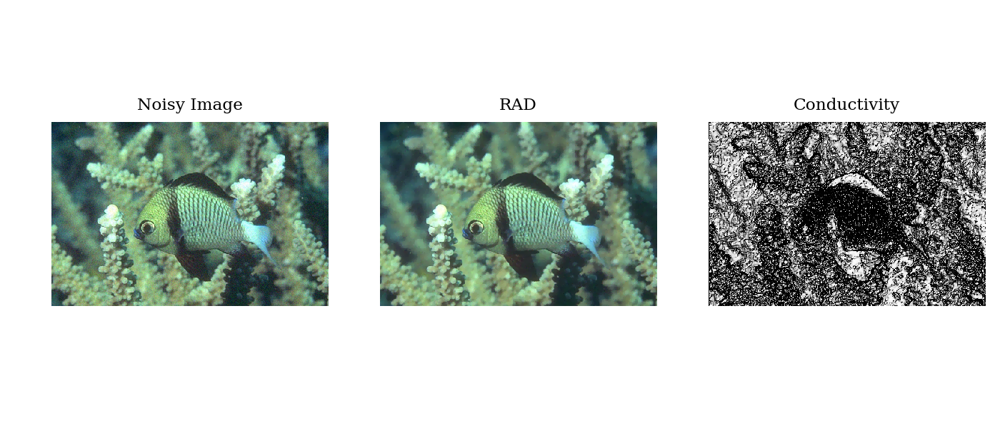

In [22]:
%matplotlib notebook
x0=plt.imread('assets/fish.png')
sig = 10/255
y = x0 + sig * np.random.randn(x0.shape[0], x0.shape[1],x0.shape[2])
x, alpha=im.anisotropic_diffusion(y, 100, 1/8, g=None, return_conductivity=True,scheme='explicit',variant=None)
fig, axes = plt.subplots(ncols=3, figsize=(7,3))
im1.show(y, ax=axes[0])
axes[0].set_title('Noisy Image')
im1.show(x, ax=axes[1])
axes[1].set_title('RAD')
im1.show(alpha, ax=axes[2])
axes[2].set_title('Conductivity')
fig.show()

# II) Question 14:

<IPython.core.display.Javascript object>


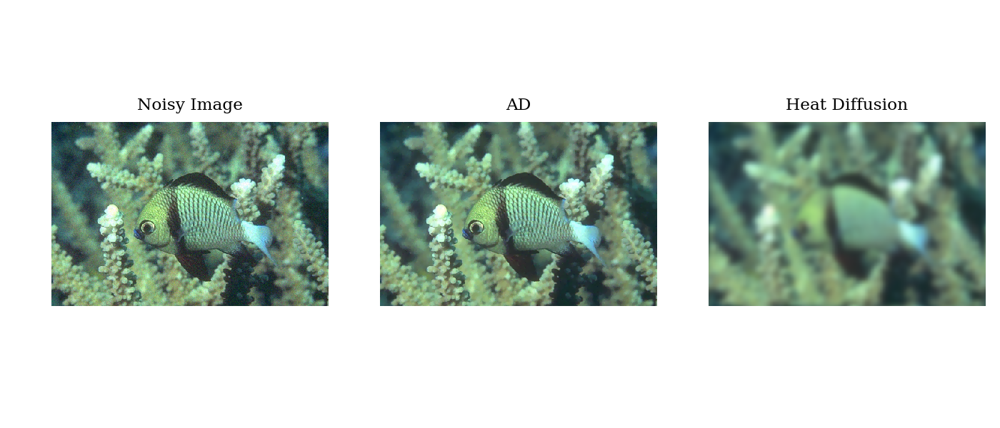

In [30]:
%matplotlib notebook
x0=plt.imread('assets/fish.png')
sig = 10/255
y = x0 + sig * np.random.randn(x0.shape[0], x0.shape[1],x0.shape[2])
x_ad=im.anisotropic_diffusion(y, 100, 1/8, g=None, return_conductivity=False,scheme='explicit',variant=None)
x_hd=im.heat_diffusion(y, 100, 1/8)
fig, axes = plt.subplots(ncols=3, figsize=(7,3))
im1.show(y, ax=axes[0])
axes[0].set_title('Noisy Image')
im1.show(x_ad, ax=axes[1])
axes[1].set_title('AD')
im1.show(x_hd, ax=axes[2])
axes[2].set_title('Heat Diffusion')
fig.show()

Both Heat diffusion and Anisotropic diffusion resemble the process that creates a scale space, where an image generates a parameterized family of successively more and more blurred images based on a diffusion process. Each of the resulting images in this family are given as a convolution between the image and a 2D isotropic Gaussian filter, where the width of the filter increases with the parameter. The following are the differences between the two:

$\textbf{Heat Diffusion:}$ 1. This is equivalent to Gaussian blurring. This is ideal for removing noise but also indiscriminately blurs edges too. 2. This diffusion process is a linear and space-invariant transformation of the original image. 3. Diffusion is homogeneous.

$\textbf{Anisotropic Diffusion:}$ 1. It reduces noise without removing significant parts of the image content, typically edges, lines or other details that are important for the interpretation of the image. 2.  Anisotropic diffusion is a non-linear and space-variant transformation of the original image. 3. It is inhomogeneous and nonlinear diffusion.

# II) Question 16:

<IPython.core.display.Javascript object>


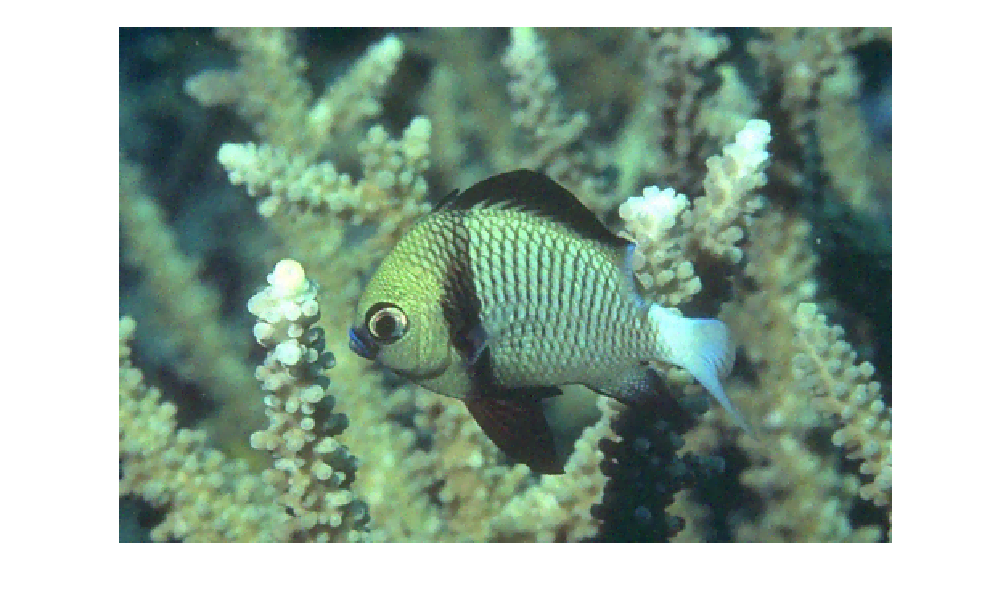

In [23]:
%matplotlib notebook
x0=plt.imread('assets/fish.png')
sig = 10/255
y = x0 + sig * np.random.randn(x0.shape[0], x0.shape[1],x0.shape[2])
x=im.anisotropic_diffusion(y, 5, 20/8, g=None, return_conductivity=False,scheme='implicit')
im1.show(x)

<IPython.core.display.Javascript object>


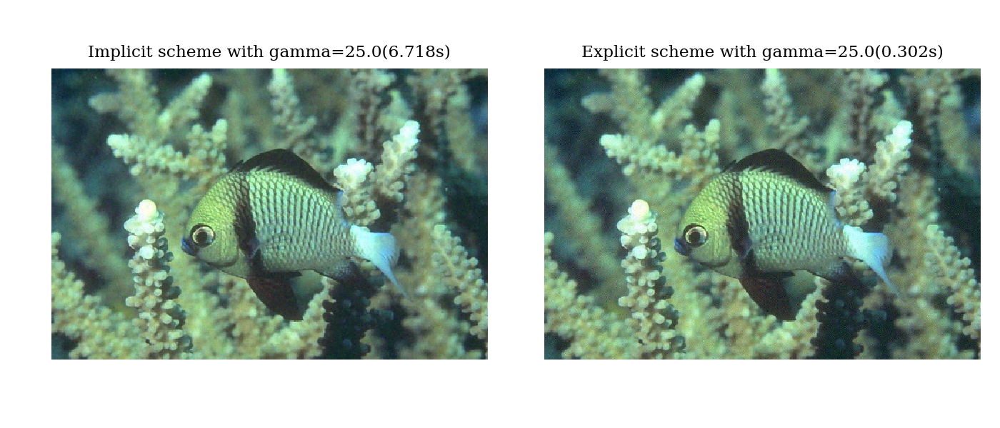

In [24]:
gamma1= 200/8; gamma2=2000/8; gamma3= 20000/8
starti1=time.time()
xi1=im.anisotropic_diffusion(y, 1, gamma1, g=None, return_conductivity=False,scheme='implicit')
endi1=time.time()
starte1=time.time()
xe1=im.anisotropic_diffusion(y, 1, gamma1, g=None, return_conductivity=False,scheme='explicit')
ende1=time.time()
fig, axes = plt.subplots(ncols=2, figsize=(7,3))
im1.show(xi1, ax=axes[0])
axes[0].set_title('Implicit scheme with gamma=' + str(gamma1) + '(' + str(round(endi1-starti1, 3)) + 's)')
im1.show(xe1, ax=axes[1])
axes[1].set_title('Explicit scheme with gamma=' + str(gamma1) + '(' + str(round(ende1-starte1, 3)) + 's)')
fig.show()

<IPython.core.display.Javascript object>


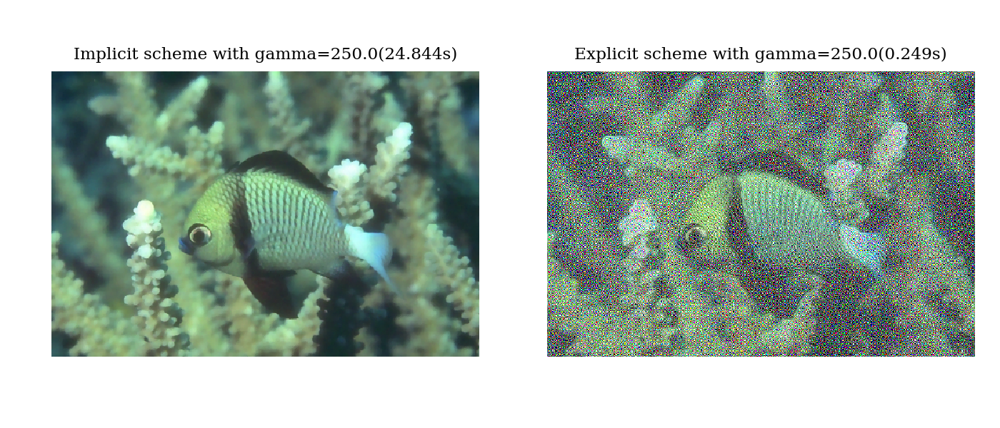

In [25]:
starti2=time.time()
xi2=im.anisotropic_diffusion(y, 1, gamma2, g=None, return_conductivity=False,scheme='implicit')
endi2=time.time()
starte2=time.time()
xe2=im.anisotropic_diffusion(y, 1, gamma2, g=None, return_conductivity=False,scheme='explicit')
ende2=time.time()
fig, axes = plt.subplots(ncols=2, figsize=(7,3))
im1.show(xi2, ax=axes[0])
axes[0].set_title('Implicit scheme with gamma=' + str(gamma2) + '(' + str(round(endi2-starti2, 3)) + 's)')
im1.show(xe2, ax=axes[1])
axes[1].set_title('Explicit scheme with gamma=' + str(gamma2) + '(' + str(round(ende2-starte2, 3)) + 's)')
fig.show()

<IPython.core.display.Javascript object>


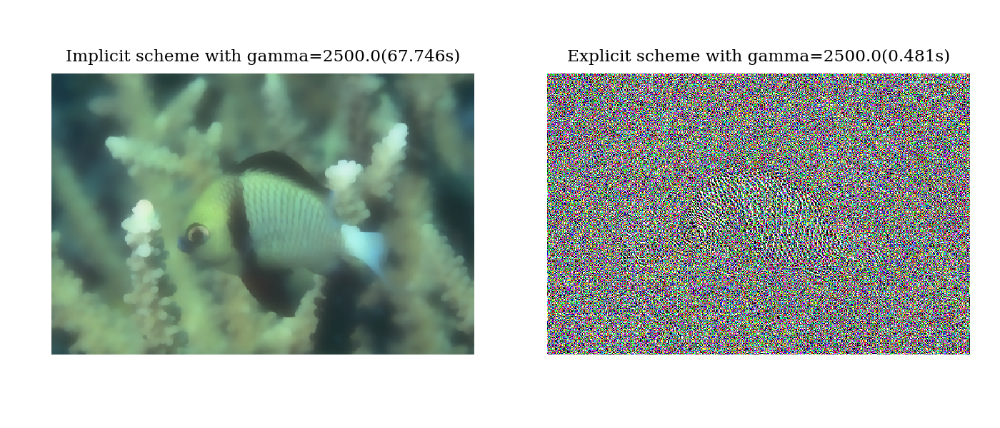

In [26]:
starti3=time.time()
xi3=im.anisotropic_diffusion(y, 1, gamma3, g=None, return_conductivity=False,scheme='implicit')
endi3=time.time()
starte3=time.time()
xe3=im.anisotropic_diffusion(y, 1, gamma3, g=None, return_conductivity=False,scheme='explicit')
ende3=time.time()
fig, axes = plt.subplots(ncols=2, figsize=(7,3))
im1.show(xi3, ax=axes[0])
axes[0].set_title('Implicit scheme with gamma=' + str(gamma3) + '(' + str(round(endi3-starti3, 3)) + 's)')
im1.show(xe3, ax=axes[1])
axes[1].set_title('Explicit scheme with gamma=' + str(gamma3) + '(' + str(round(ende3-starte3, 3)) + 's)')
fig.show()

Conclusion: As the gamma parameter increases in the case of both the models, The resultant denoised image by the explicit scheme is noisy while the implicit scheme removes the noise and blurs the image but with some edge preservation. 

# Section 3: Truly Anisotropic Diffusion

# Question 21

In [18]:
x0=plt.imread('assets/mushroom.png')
sig = 10/255
y = x0 + sig * np.random.randn(x0.shape[0],x0.shape[1],x0.shape[2])
start_ad=time.time()
x_ad=im.anisotropic_diffusion(y, 100, 1/8, g=None, return_conductivity=False,scheme='explicit',variant=None)
end_ad=time.time()
start_tad=time.time()
x_tad, alpha=im.anisotropic_diffusion(y, 100, 1/8, g=None, return_conductivity=True,variant='truly')
end_tad= time.time()

<IPython.core.display.Javascript object>


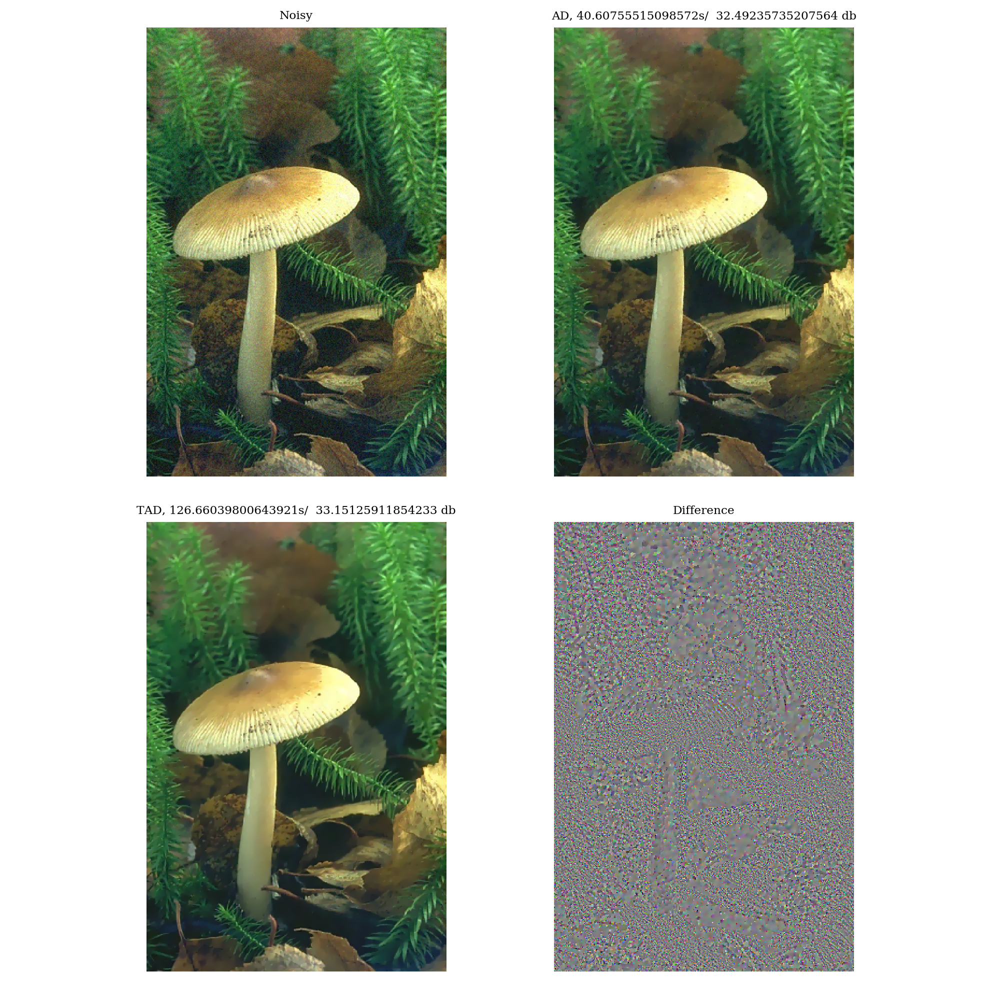

In [19]:
fig, axes = plt.subplots(nrows =2, ncols=2, figsize=(10,10))
im1.show(y, ax=axes[0][0])
axes[0][0].set_title('Noisy')
im1.show(x_ad, ax=axes[0][1])
axes[0][1].set_title('AD, '  + str(end_ad-start_ad) + 's/  ' + str(im.psnr(x0,x_ad)) + ' db')
im1.show(x_tad, ax=axes[1][0])
axes[1][0].set_title('TAD, '  + str(end_tad-start_tad) + 's/  ' + str(im.psnr(x0,x_tad)) + ' db')
im1.show((x_tad-x_ad), vmin=-0.05, vmax=0.05, ax=axes[1][1])
axes[1][1].set_title('Difference')
fig.show()

# Question 22

In [14]:
x0=plt.imread('assets/mushroom.png')
sig = 10/255
y = x0 + sig * np.random.randn(x0.shape[0],x0.shape[1],x0.shape[2])
start_ad=time.time()
x_ad=im.anisotropic_diffusion(y, 5, 20/8, g=None, return_conductivity=False,scheme='implicit',variant=None)
end_ad=time.time()
start_tad=time.time()
x_tad=im.anisotropic_diffusion(y, 5, 20/8, g=None, return_conductivity=False,scheme='implicit',variant ='truly')
end_tad= time.time()


<IPython.core.display.Javascript object>


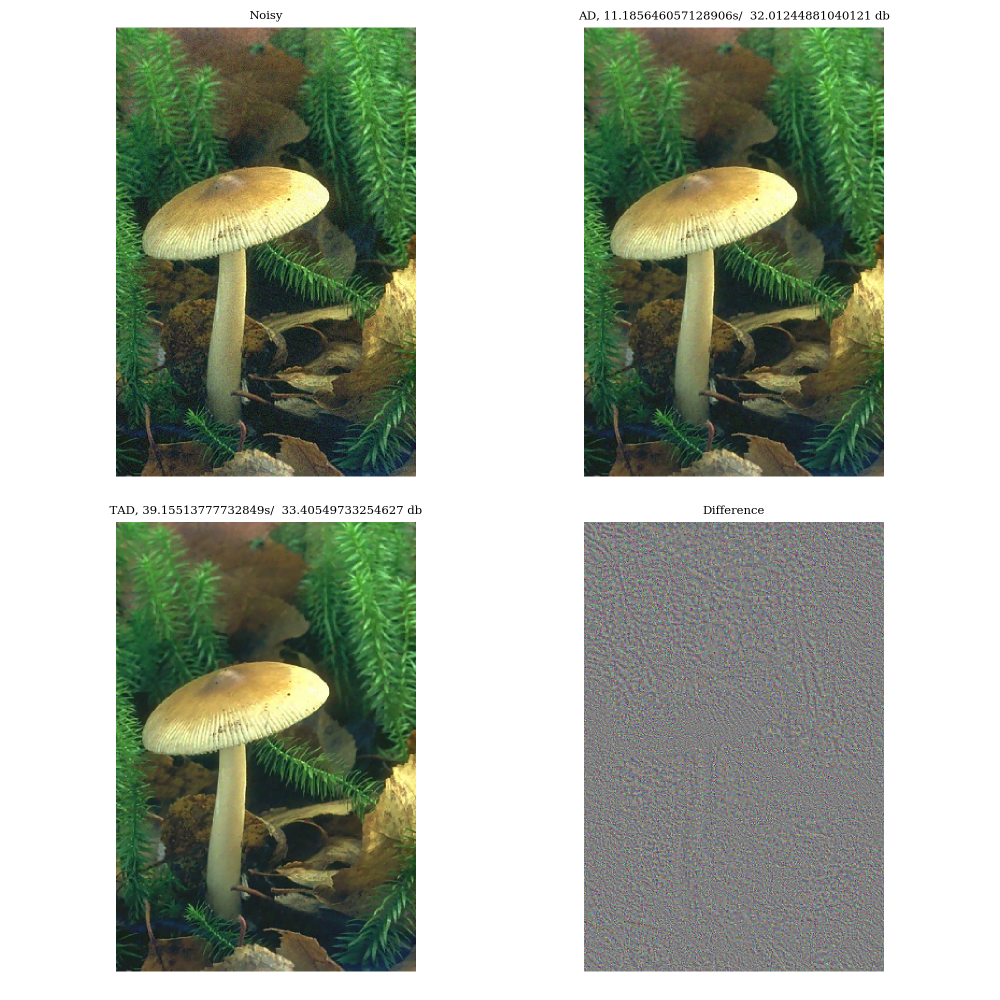

In [17]:
fig, axes = plt.subplots(nrows =2, ncols=2, figsize=(10,10))
im1.show(y, ax=axes[0][0])
axes[0][0].set_title('Noisy')
im1.show(x_ad, ax=axes[0][1])
axes[0][1].set_title('AD, '  + str(end_ad-start_ad) + 's/  ' + str(im.psnr(x0,x_ad)) + ' db')
im1.show(x_tad, ax=axes[1][0])
axes[1][0].set_title('TAD, '  + str(end_tad-start_tad) + 's/  ' + str(im.psnr(x0,x_tad)) + ' db')
im1.show((x_tad-x_ad), vmin=-0.05, vmax=0.05, ax=axes[1][1])
axes[1][1].set_title('Difference')
fig.show()

From the 'difference' figure we can notice a outline of the mushroom. And we also notice from the time printed on the figures that implicit is much faster than explicit

# Section 4 Regularization for image restoration 

# Question 24

Mathematical foundation of the regularization **Anisotropic diffusion** approach:
$$ F(x)=\frac{1}{2}\int (Hx-y)^2 +\tau G( \lVert {\nabla G_{\sigma}*x}\rVert ^2)ds$$
$$\nabla F(x)=H*(Hx-y)-\tau div(g(\lVert \nabla G_{\sigma}*x^k\rVert^2)\nabla x^k) $$
where $$g(u)=G'(u)$$
The gradient descent becomes:
$$x^{k+1}=x^k-\gamma (H*(Hx^k-y)-\tau div(g(\lVert \nabla G_{\sigma}*x^k\rVert^2)\nabla x^k) $$
As anisotropic step is with :

$$x^{k+1}_{AD}(\gamma)=x^k+\gamma ( div(g(\lVert \nabla G_{\sigma}*x^k\rVert^2)\nabla x^k)$$

We conclude by saying that regularization with anisotropic approach is equivalent to:

$$ \mathbf{x^{k+1}=x^{k+1}_{AD}(\gamma*\tau)- \gamma*(H*(Hx^k-y))}$$


Similarly the mathematical foundation of the **truly anisotropic approach** is:

$$ \mathbf{x^{k+1}=x^{k+1}_{TAD}(\gamma*\tau)- \gamma*(H*(Hx^k-y))}$$

where $x^{k}_{TAD}$ is truly anisotropic diffusion is:

$$ M^k=(\nabla G_{\sigma}*x^k) (\nabla G_{\sigma}*x^k)^T $$

$$ M^k_{conv}=G_{\sigma}*M^k$$

$$ T^k=h[M^k_{conv}]$$

$$ \nu^k=T^k \times \nabla x^k$$

$$ x^{k+1}=x^k + \gamma div (\nu^k)$$

# Question 25

In [20]:
%matplotlib notebook
x0=plt.imread('assets/moose.png')
sig=2/255
shape=x0.shape
nu=im.kernel('motion')
H_b = im.Convolution(shape, nu, separable=None)
x=H_b(x0)
y = x + sig * np.random.randn(x.shape[0], x.shape[1],x.shape[2])

In [22]:
start_ad=time.time()
x_ad=im.anisotropic_diffusion_regularization(y=y, m=1000, gamma=1/8,sig=2/255, H=H_b, g=None,tau=0.5, variant=None)
end_ad=time.time()

Iteration 0
Iteration 100
Iteration 200
Iteration 300
Iteration 400
Iteration 500
Iteration 600
Iteration 700
Iteration 800
Iteration 900


In [21]:
start_tad=time.time()
x_tad=im.anisotropic_diffusion_regularization(y=y, m=1000, gamma=1/8,sig=2/255, H=H_b, g=None,tau=0.5, variant='truly')
end_tad=time.time()

Iteration 0
Iteration 100
Iteration 200
Iteration 300
Iteration 400
Iteration 500
Iteration 600
Iteration 700
Iteration 800
Iteration 900


<IPython.core.display.Javascript object>


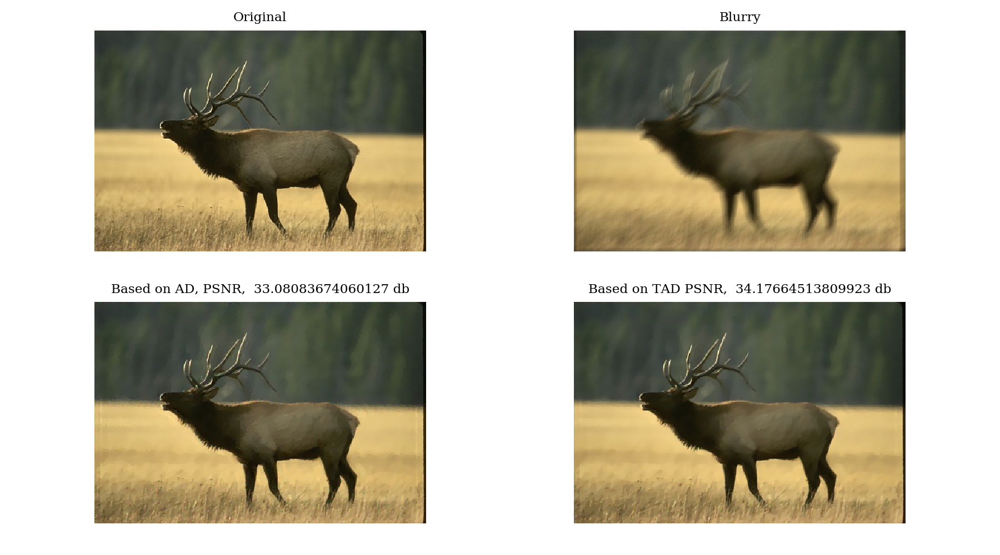

Text(0.5, 1.0, 'Based on TAD PSNR,  34.17664513809923 db')

In [24]:
fig, axes = plt.subplots(nrows=2,ncols=2, figsize=(9,5))
im1.show(x0, ax=axes[0][0])
axes[0][0].set_title('Original')
im1.show(y, ax=axes[0][1])
axes[0][1].set_title('Blurry')
im1.show(x_ad, ax=axes[1][0])
axes[1][0].set_title('Based on AD, ' + 'PSNR,  ' +str(im.psnr(x0,x_ad)) + ' db')
im1.show(x_tad, ax=axes[1][1])
axes[1][1].set_title('Based on TAD ' + 'PSNR,  '+ str(im.psnr(x0,x_tad)) + ' db')

In [23]:
print('based on AD time taken is',(end_ad-start_ad))
print('based on TAD time taken is',(end_tad-start_tad))

based on AD time taken is 1280.822212934494
based on TAD time taken is 2153.6322960853577


# Question 26

In [25]:
%matplotlib notebook
x0=plt.imread('assets/moose.png')
sig=2/255
shape=x0.shape
H_r = im.RandomMasking(shape, 0.4)
x=H_r(x0)
y = x + sig * np.random.randn(x.shape[0], x.shape[1],x.shape[2])

In [26]:
startrad=time.time()
x_r_ad=im.anisotropic_diffusion_regularization(y=y, m=1000, gamma=1/4,sig=2/255, H=H_r, g=None,tau=50, variant=None)
endrad=time.time()

Iteration 0
Iteration 100
Iteration 200
Iteration 300
Iteration 400
Iteration 500
Iteration 600
Iteration 700
Iteration 800
Iteration 900


In [27]:
startrtad=time.time()
x_r_tad=im.anisotropic_diffusion_regularization(y=y, m=1000, gamma=1/8,sig=2/255, H=H_r, g=None,tau=50, variant='truly')
endrtad=time.time()

Iteration 0
Iteration 100
Iteration 200
Iteration 300
Iteration 400
Iteration 500
Iteration 600
Iteration 700
Iteration 800
Iteration 900


<IPython.core.display.Javascript object>


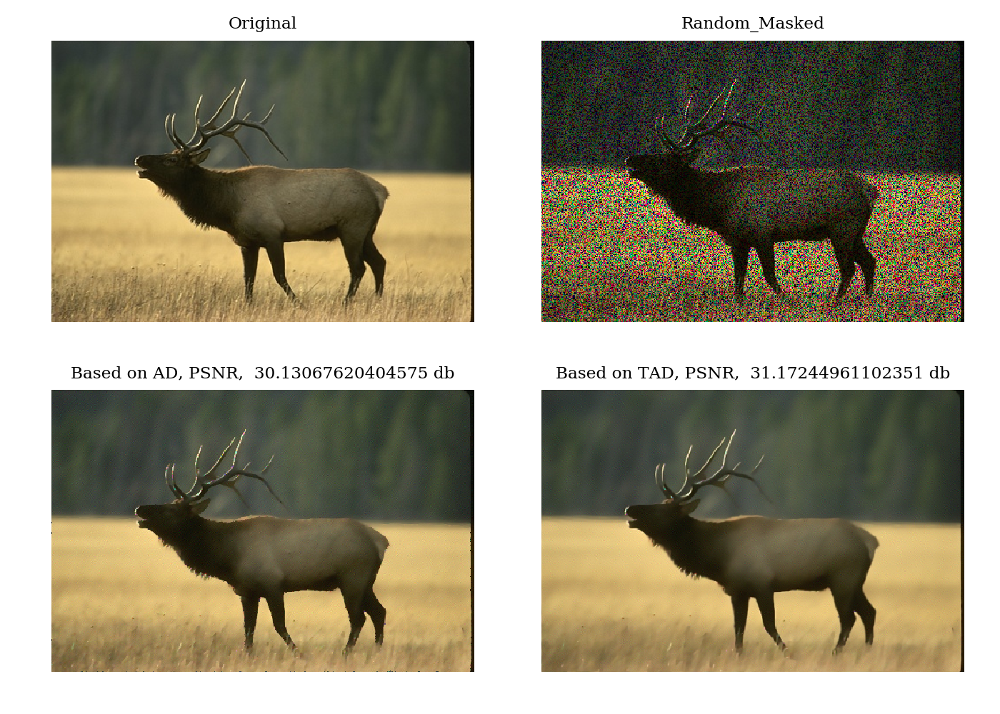

Text(0.5, 1.0, 'Based on TAD, PSNR,  31.17244961102351 db')

In [28]:
fig, axes = plt.subplots(nrows=2,ncols=2, figsize=(7,5))
im1.show(x0, ax=axes[0][0])
axes[0][0].set_title('Original')
im1.show(y, ax=axes[0][1])
axes[0][1].set_title('Random_Masked')
im1.show(x_r_ad, ax=axes[1][0])
axes[1][0].set_title('Based on AD, ' + 'PSNR,  '+ str(im.psnr(x0,x_r_ad)) + ' db')
im1.show(x_r_tad, ax=axes[1][1])
axes[1][1].set_title('Based on TAD, ' + 'PSNR,  ' + str(im.psnr(x0,x_r_tad)) + ' db')

In [30]:
print('based on AD time taken is',(endrad-startrad))
print('based on TAD time taken is',(endrtad-startrtad))

based on AD time taken is 412.1729009151459
based on TAD time taken is 1255.7211890220642


# Bonus

# V) Super-Resolution:

<IPython.core.display.Javascript object>


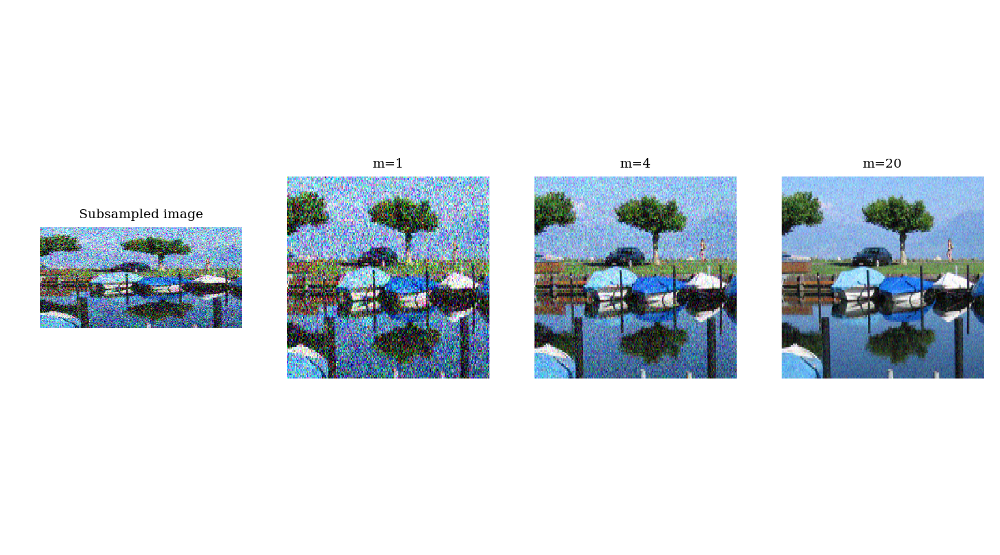

In [29]:
%matplotlib notebook
x=plt.imread('assets/lake.png')
p1, p2 = x.shape[:2]
sigma = 60/255
m = 1
H = lambda x: (x[0::2, :] + x[1::2, :]) / 2
y = np.array([ H(x) + sigma * np.random.randn(int(p1 / 2), p2, 3) for k in range(m) ])
Ha = lambda x: x[[int(i/2) for i in range(p1)], :] / 2
ybar = np.mean(y, axis=0)
xblue = im.cg(lambda x: Ha(H(x)), Ha(ybar))
fig, axes = plt.subplots(ncols=4, figsize=(9,5))
im1.show(y, ax=axes[0])
axes[0].set_title('Subsampled image')
im1.show(xblue, ax=axes[1])
axes[1].set_title('m=1')
m=4
y = [ H(x) + sigma * np.random.randn(int(p1 / 2), p2, 3) for k in range(m) ]
Ha = lambda x: x[[int(i/2) for i in range(p1)], :] / 2
ybar = np.mean(y, axis=0)
xblue = im.cg(lambda x: Ha(H(x)), Ha(ybar))
im1.show(xblue, ax=axes[2])
axes[2].set_title('m=4')
m=20
y = [ H(x) + sigma * np.random.randn(int(p1 / 2), p2, 3) for k in range(m) ]
Ha = lambda x: x[[int(i/2) for i in range(p1)], :] / 2
ybar = np.mean(y, axis=0)
xblue = im.cg(lambda x: Ha(H(x)), Ha(ybar))
im1.show(xblue, ax=axes[3])
axes[3].set_title('m=20')
fig.show()

# Imagetools 

In [ ]:
""" Project A

COMPLETE THIS FILE

Gitika Meher, Nasha, Khushboo Agrawal:

"""
import numpy as np
from .assignment6 import *

class Identity(LinearOperator):
    def __init__(self, ishape):
        self.shape=ishape
        oshape=ishape
        LinearOperator.__init__(self, ishape, oshape)
        self.H= np.ones(self.ishape, dtype=int)
                
    def __call__(self, x):
        return convolvefft(x, self.H)
    
    def adjoint(self, x):
        return convolvefft(x, np.conjugate(self.H))
    
    def gram(self, x):
        return convolvefft(x, np.conjugate(self.H)*self.H)
    
    def gram_resolvent(self, x, tau):
        return cg(lambda z: z + tau * self.gram(z), x)
        
class Convolution(LinearOperator):
    def __init__(self, shape, nu, separable=None):
        self.n1=shape[0];self.n2=shape[1]
        self.nu=nu
        self.separable=separable
        self.ker=kernel2fft(self.nu, self.n1, self.n2, separable=self.separable)
        LinearOperator.__init__(self, shape, shape)
    
    def __call__(self, x):
        return convolvefft(x, self.ker)
    
    def adjoint(self, x):
        return convolvefft(x, np.conjugate(self.ker))
    
    def gram(self, x):
        return convolvefft(x, np.conjugate(self.ker)*self.ker)
    
    def gram_resolvent(self, x, tau):
        return cg(lambda z: z + tau * self.gram(z), x)

class RandomMasking(LinearOperator):
    def __init__(self, shape, p):
        LinearOperator.__init__(self, shape, shape)
        self.total= np.prod(np.array(shape))
        self.no_zeros= p*self.total
        if len(shape)==2:
            self.shape=(shape[0], shape[1], 1)
        else:
            self.shape=shape
        self.H=np.ones(self.shape)
        counter=0
        while counter <= self.no_zeros:
            (i,j,k)=(np.random.randint(1,self.shape[0]+1),np.random.randint(1,self.shape[1]+1),np.random.randint(1,self.shape[2]+1))
            if self.H[i-1,j-1,k-1]==1:
                counter+=1
                self.H[i-1,j-1,k-1]=0
                
    def __call__(self, x):
        return self.H*x
        
    def adjoint(self, x):
        return self.H*x
    
    def gram(self, x):
        return self.H*self.H*x
    
    def gram_resolvent(self, x, tau):
        return cg(lambda z: z + tau * self.gram(z), x)
        
def heat_diffusion(y, m, gamma, scheme='continuous'):
    n1,n2=y.shape[0], y.shape[1]
    nu = (kernel('laplacian1_'),kernel('laplacian2_'))
    L = kernel2fft(nu, n1, n2, separable='sum')
    if scheme=='explicit':
        K_ee = (1 + gamma * L)**m
        x = convolvefft(y, K_ee)
        
    if scheme=='implicit':
        K_ie = 1 / (1 - gamma * L)**m
        x = convolvefft(y, K_ie)

    if scheme=='continuous':
        u, v = fftgrid(n1, n2)
        K_cs = np.exp(-(u**2 + v**2) / (4*gamma*m)) / (4*np.pi*gamma*m)
        K_cs = np.fft.fft2(K_cs, axes=(0, 1))
        x = convolvefft(y, K_cs)
    return x
        
def norm2(v, keepdims=True):
    if(len(v.shape)==3):
        v=np.reshape(v, (v.shape[0],v.shape[1],1, v.shape[2]))
    elif (len(v.shape)==1):
        v=np.reshape(v, (v.shape[0],v.shape[1],1))
    norm= lambda v1, v2: v1**2 + v2**2
    if(len(v.shape)==4):
        a= norm(v[:,:, 0, :], v[:,:,1, :])
    else:
        a= norm(v[:,:, 0], v[:,:,0])/2
    if len(a.shape)==3 and a.shape[2]==3:
        a=np.sum(a,axis=-1)
        if keepdims==True:
            a=np.reshape(a, (a.shape[0],a.shape[1],1,1 ))
    else:
        if keepdims==True:
            a=np.reshape(a, (a.shape[0],a.shape[1],1 ))
    return a  

def anisotropic_step(x, z, gamma, g, nusig, return_conductivity=False): 
    x_conv = convolve(x, nusig)
    alpha = g(norm2(grad(x_conv)))
    x = z + gamma * div(alpha * grad(z))
    if return_conductivity:
        return x, alpha
    else:
        return x
def tensorize(v, nurho):
    n1, n2, p = v.shape[:3]
    M = np.zeros((n1, n2, p, p))
    v_pq = np.zeros((n1,n2))
    for k in range(p):
        for l in range(p):
            if np.ndim(v) == 3:
                vv_pq = np.multiply(v[:,:,k],v[:,:,l])
            else:
                import pdb
#                 pdb.set_trace()
                vv_pq = np.sum(np.multiply(v[:,:,k,:],v[:,:,l,:]),axis=-1)
            #remember to sum across the three channels for the colour images
            M[:,:,k,l] = convolve(x = vv_pq,nu = nurho,boundary = 'periodical') 
    return M

def matrix_spectral_func(M, g):
    a = np.zeros_like(M)
    #find the eigenvalues of M along the last two dimension
    u,s,vh = np.linalg.svd(M, compute_uv=True)
    
    
    A = g(s)
    
    T = u @ (A[..., None] * vh)
    
    return T
def truly_anisotropic_step(x, z, gamma, g, nusig, nurho,
return_conductivity=False):
    
    
    #step 1
    v0 = grad(convolve(x,nu = nusig,boundary = 'periodical'))
    #step 2
    M = tensorize(v0,nurho)

    n1,n2, p = M.shape[:3]
    #step 3
    T = matrix_spectral_func(M,g)
    #step 4

    v = np.zeros((n1,n2,p))
    if np.ndim(x) == 3:
        x0 = grad(z)
        v = (np.matmul(T,x0))
    else:
        x0 = grad(z).reshape(n1,n2,p,1)
        v = (np.matmul(T,x0)).reshape(n1,n2,p)
    #finallly
    x =z + gamma*div(v)

    if return_conductivity:
        return x, T
    else:
        return x    
    
def anisotropic_diffusion(y, m, gamma, g=None, return_conductivity=False, scheme='explicit',variant =None):
    if variant is 'truly':
        if scheme=='implicit':
            return_conductivity=False
        x = y
        z=y
        if len(y.shape)==3:
            C=3
        else:
            C=1
        if g==None:
            g= lambda u: 10 / (10 + 255*255*u/(np.sqrt(C)))
        nusig = kernel('gaussian', tau=0.2, s1=1, s2=1)
        nurho = kernel(name ='gaussian',tau = 0.5, s1=1,s2=1)

        for k in range(m):
            if scheme=='explicit':

                x, alpha= truly_anisotropic_step(x, x, gamma, g, nusig,nurho, return_conductivity=return_conductivity)
            elif scheme=='implicit':
                
                x = cg(lambda z: truly_anisotropic_step(x, z, -gamma, g, nusig,nurho, return_conductivity=return_conductivity), x)
        if return_conductivity:
            return x, alpha
        else:
            return x
    if variant is None:
               
        if scheme=='implicit':
            return_conductivity=False
        x = y
        if (len(x.shape)==3):
            C=3
        else:
            C=1
        if g==None:
            g= lambda u: 10 / (10 + 255*255*u/(np.sqrt(C)))
        nusig = kernel('gaussian', tau=0.2, s1=1, s2=1)
        for k in range(m):
            if scheme=='explicit':
                if return_conductivity:
                    x, alpha= anisotropic_step(x, x, gamma, g, nusig, return_conductivity=return_conductivity)
                else:
                    x = anisotropic_step(x, x, gamma, g, nusig, return_conductivity=return_conductivity)
            elif scheme=='implicit':

                x= cg(lambda z: anisotropic_step(x, z, -gamma, g, nusig, return_conductivity=return_conductivity), x)
        if return_conductivity:
            return x, alpha
        else:
            return x
        
        
def regularization_step(y, z, g,nusig,nurho,gamma, tau,H,variant=None):
    if variant==None:
        ret=H.adjoint((H(z)-y))
        x = anisotropic_step(z, z, gamma*tau, g, nusig, return_conductivity=False) - gamma*ret
        return x
    else:
        ret=H.adjoint((H(z)-y))
        x = truly_anisotropic_step(z, z, gamma*tau, g, nusig, nurho,return_conductivity=False) - gamma*ret
        return x
    
    
    
def anisotropic_diffusion_regularization(y, m, gamma,sig=2/255, H=None, g=None,tau=0.5, variant=None):
    shape=y.shape
    if H==None:
        H=Identity(shape)
    x=y
    if len(y.shape)==3:
        C=3
    else:
        C=1
    nusig = kernel('gaussian', tau=0.2, s1=1, s2=1)
    nurho = kernel(name ='gaussian',tau = 0.5, s1=1,s2=1)
    if g==None:
        g= lambda u: sig**2 / (sig**2 + u/(np.sqrt(C)))
    if variant==None:
        for k in range(m):
            if k%100==0:
                print('Iteration',k)
            x=regularization_step(y, x, g,nusig,nurho,gamma, tau,H,variant=None)
        return x
    else:
        for k in range(m):
            if k%100==0:
                print('Iteration',k)
            x=regularization_step(y, x, g,nusig,nurho,gamma, tau,H,variant='truly')
        return x            
 